```
Name: Anton Priyanka
UNI: ap3901

I have worked on this without a partner.
```

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'svg'
import os
import warnings
warnings.simplefilter('ignore')

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [5]:
df = pd.read_csv('vehicles.csv')

In [6]:
pd.set_option('display.max_columns', None)
df.head(5)

,id,url,region,region_url,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,size,type,paint_color,image_url,description,county,state,lat,long
0,7034441763,https://saltlakecity.craigslist.org/cto/d/salt...,salt lake city,https://saltlakecity.craigslist.org,17899,2012.0,volkswagen,golf r,excellent,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,compact,hatchback,black,https://images.craigslist.org/00G0G_fTLDWM5Xyv...,PRICE REDUCED! -Garage kept -Low Miles (63K)...,NaN,ut,40.7372,-111.858
1,7034440610,https://saltlakecity.craigslist.org/ctd/d/sand...,salt lake city,https://saltlakecity.craigslist.org,0,2016.0,ford,f-150,excellent,NaN,gas,10.0,clean,automatic,1FTMF1EP3GKF13544,4wd,NaN,NaN,NaN,https://images.craigslist.org/00v0v_7Cu0buIofU...,Drive it home today. Call (Or Text) us now !!C...,NaN,ut,40.5881,-111.884
2,7034440588,https://saltlakecity.craigslist.org/ctd/d/sand...,salt lake city,https://saltlakecity.craigslist.org,46463,2015.0,gmc,sierra 1500,excellent,NaN,gas,7554.0,clean,automatic,3GTU2WEC6FG228025,4wd,NaN,NaN,white,https://images.craigslist.org/01515_lPvJ9bfbdY...,Drive it home today. Call (Or Text) us now !!C...,NaN,ut,40.5881,-111.884
3,7034440546,https://saltlakecity.craigslist.org/ctd/d/sand...,salt lake city,https://saltlakecity.craigslist.org,0,2016.0,ford,f-150,excellent,NaN,gas,10.0,clean,automatic,1FTEX1EF6GKD25447,4wd,NaN,NaN,NaN,https://images.craigslist.org/00T0T_6Rjfp3NS4O...,Drive it home today. Call (Or Text) us now !!C...,NaN,ut,40.5881,-111.884
4,7034406932,https://saltlakecity.craigslist.org/ctd/d/evan...,salt lake city,https://saltlakecity.craigslist.org,49999,2018.0,ford,f-450,NaN,NaN,diesel,70150.0,clean,automatic,1FT8W4DT8GEA90427,4wd,NaN,pickup,white,https://images.craigslist.org/00W0W_8yIUwRBXXd...,2018 Ford F-350 F350 F 350 SD Lariat Crew Cab ...,NaN,ut,40.3744,-104.694


# Task1 & Task2

In [100]:
#dropping columns which doesn't seem to informative
drop_columns = ['id','county','url', 'region', 'region_url', 'title_status', 'vin', 'size', 
                'image_url', 'description', 'lat','long', 'paint_color']
vehicles_df = df.drop(columns = drop_columns)
vehicles_df = vehicles_df.dropna()
vehicles_df.shape
vehicles_df.head()

,price,year,manufacturer,model,condition,cylinders,fuel,odometer,transmission,drive,type,state
0,17899,2012.0,volkswagen,golf r,excellent,4 cylinders,gas,63500.0,manual,4wd,hatchback,ut
24,4600,2008.0,honda,civic,good,4 cylinders,gas,110982.0,automatic,fwd,sedan,ut
48,28000,2004.0,ford,f550 mechanics service,good,10 cylinders,gas,67348.0,automatic,4wd,truck,ut
52,18999,2015.0,mercedes-benz,cla-class,excellent,4 cylinders,gas,37000.0,automatic,fwd,sedan,ut
53,79997,2016.0,mercedes-benz,amg gts,excellent,8 cylinders,gas,28000.0,automatic,rwd,coupe,ut


The 'ID' column could leak target information because the Machine Learning models would learn using the 'ID' column due to its heavy correlation with the target information. Hence we need to remove that column.

Along with that I have dropped few other columns which I felt may not be helpful.

In [196]:
print ("Top 10 most used price points:")
print (vehicles_df['price'].value_counts().iloc[:20])

Top 10 most used price points:
0        6913
1        1799
3500     1782
4500     1772
6995     1741
5995     1663
2500     1596
4995     1518
5500     1495
7995     1486
8995     1477
6500     1387
7500     1250
9995     1245
3995     1227
3000     1139
5000     1119
10995    1093
4000     1071
8500     1053
Name: price, dtype: int64


In [101]:
vehicles_df = vehicles_df.loc[vehicles_df['price'] > 100]

# After Removing price values that are too low to be true

In [198]:

print ("Top 10 most used price points:")
print (vehicles_df['price'].value_counts().iloc[:20])

Top 10 most used price points:
3500     1782
4500     1772
6995     1741
5995     1663
2500     1596
4995     1518
5500     1495
7995     1486
8995     1477
6500     1387
7500     1250
9995     1245
3995     1227
3000     1139
5000     1119
10995    1093
4000     1071
8500     1053
12995    1029
1500     1019
Name: price, dtype: int64


In [199]:
print (vehicles_df.price.describe())

count    1.454420e+05
mean     7.126115e+04
std      1.347752e+07
min      1.080000e+02
25%      4.950000e+03
50%      8.990000e+03
75%      1.599900e+04
max      3.600029e+09
Name: price, dtype: float64


In [200]:
vehicles_df.shape

(145442, 12)

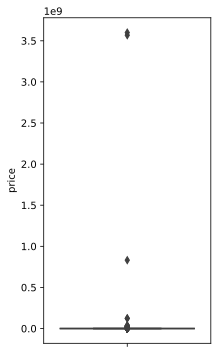

In [9]:
plt.figure(figsize=(3,6))
sns.boxplot(y=vehicles_df['price'], data=vehicles_df);

In [102]:
# There are few price values that are unusually high. For now let's just keep below 200000 and proceed further
vehicles_df = vehicles_df.loc[vehicles_df['price'] < 200000]
vehicles_df.shape

(145408, 12)

In [103]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 8}

plt.rc('font', **font)


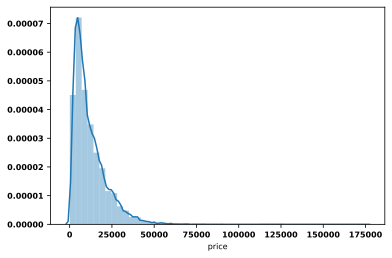

In [12]:
sns.distplot(vehicles_df['price'])

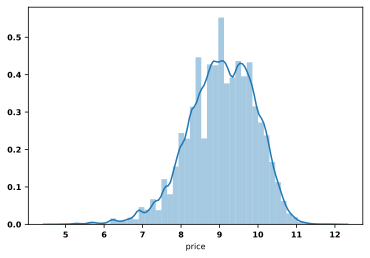

In [13]:
#normalized distribution
sns.distplot(np.log(vehicles_df['price']))

In [11]:
vehicles_df.head()

,price,year,manufacturer,model,condition,cylinders,fuel,odometer,transmission,drive,type,state
0,17899,2012.0,volkswagen,golf r,excellent,4 cylinders,gas,63500.0,manual,4wd,hatchback,ut
24,4600,2008.0,honda,civic,good,4 cylinders,gas,110982.0,automatic,fwd,sedan,ut
48,28000,2004.0,ford,f550 mechanics service,good,10 cylinders,gas,67348.0,automatic,4wd,truck,ut
52,18999,2015.0,mercedes-benz,cla-class,excellent,4 cylinders,gas,37000.0,automatic,fwd,sedan,ut
53,79997,2016.0,mercedes-benz,amg gts,excellent,8 cylinders,gas,28000.0,automatic,rwd,coupe,ut


In [208]:
vehicles_df.state.unique()
#The state column seems to have many unique values. So we should do Target Encoding

array(['ut', 'vt', 'va', 'wa', 'wv', 'wi', 'wy', 'al', 'ak', 'az', 'ar',
       'ca', 'co', 'ct', 'dc', 'fl', 'de', 'ga', 'hi', 'id', 'il', 'in',
       'ia', 'ks', 'ky', 'la', 'me', 'md', 'ma', 'mi', 'mn', 'ms', 'mo',
       'mt', 'nc', 'ne', 'nv', 'nj', 'nm', 'ny', 'nh', 'nd', 'oh', 'ok',
       'or', 'pa', 'ri', 'sc', 'tn', 'sd', 'tx'], dtype=object)

In [ ]:
vehicles_df.model.unique().tolist()
#not running this cell, since there are too many values

In [104]:
#The model column seems to be very vague and so this column could be removed
vehicles_df = vehicles_df.drop(['model'],axis=1)

In [211]:
vehicles_df.manufacturer.unique()
#The manufacturer column seems to have many unique values. So we should do Target Encoding

array(['volkswagen', 'honda', 'ford', 'mercedes-benz', 'bmw', 'ram',
       'nissan', 'subaru', 'rover', 'alfa-romeo', 'jeep', 'gmc', 'toyota',
       'saturn', 'dodge', 'chrysler', 'chevrolet', 'hyundai', 'pontiac',
       'mitsubishi', 'lexus', 'mini', 'audi', 'kia', 'lincoln', 'mazda',
       'acura', 'buick', 'volvo', 'cadillac', 'infiniti', 'jaguar',
       'fiat', 'mercury', 'harley-davidson', 'tesla', 'datsun', 'ferrari',
       'land rover', 'aston-martin', 'porche', 'morgan', 'hennessey'],
      dtype=object)

In [212]:
vehicles_df.fuel.unique()

array(['gas', 'diesel', 'other', 'hybrid', 'electric'], dtype=object)

In [213]:
vehicles_df.type.unique()

array(['hatchback', 'sedan', 'truck', 'coupe', 'van', 'SUV',
       'convertible', 'pickup', 'wagon', 'other', 'offroad', 'mini-van',
       'bus'], dtype=object)

In [15]:
pip install category_encoders

Note: you may need to restart the kernel to use updated packages.


In [16]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.compose import make_column_selector
from category_encoders.target_encoder import TargetEncoder
from sklearn.compose import TransformedTargetRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectPercentile, f_regression

from sklearn.compose import make_column_transformer
from sklearn.compose import make_column_selector
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold, RepeatedStratifiedKFold, ShuffleSplit,RepeatedKFold
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.svm import LinearSVC
from sklearn.svm import SVR

from sklearn.preprocessing import PolynomialFeatures

# Let's visualize and learn the influence of categorical features

In [12]:
cols = vehicles_df.columns
num_cols = vehicles_df._get_numeric_data().columns

print('Continuous Features: ', list(num_cols))
cat_cols = list(set(cols) - set(num_cols))
print("")
print('Categorical Features: ', cat_cols)

Continuous Features:  ['price', 'year', 'odometer']

Categorical Features:  ['cylinders', 'transmission', 'drive', 'manufacturer', 'type', 'state', 'fuel', 'condition']


In [17]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 10
fig_size[1] = 8
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 12}

plt.rc('font', **font)


In [18]:
v_sample = vehicles_df.sample(10000)
plt.barh(v_sample['state'], v_sample['price'])


<BarContainer object of 10000 artists>

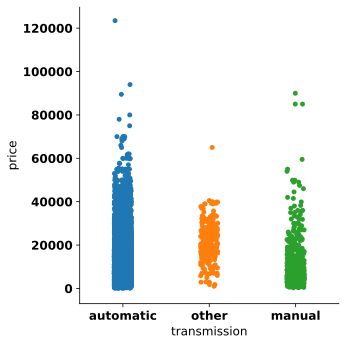

In [19]:
v_transmission = v_sample[['transmission','price']]
sns.catplot(x="transmission", y="price", data=v_transmission)

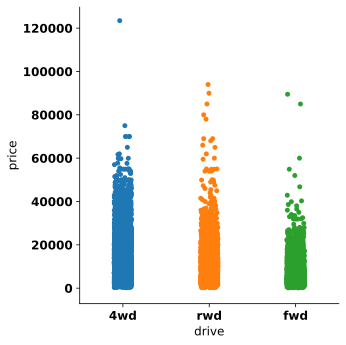

In [20]:
v_drive = v_sample[['drive','price']]
sns.catplot(x="drive", y="price", data=v_drive)

In [ ]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 8}

plt.rc('font', **font)


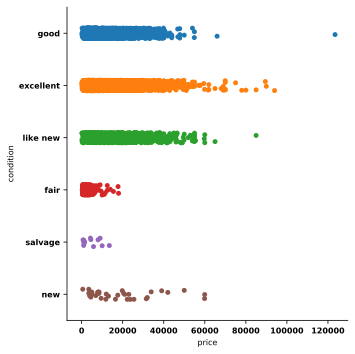

In [105]:
# 'transmission', 'drive', 'condition', 'state', 'fuel', 'cylinders', 'manufacturer', 'type'
v_condition = v_sample[['price','condition']]
sns.catplot(x="price", y="condition", data=v_condition)

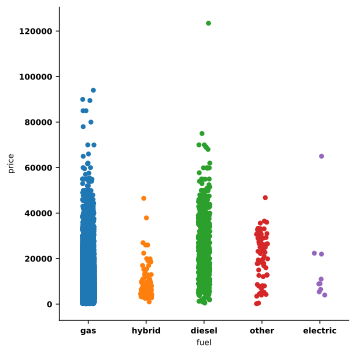

In [106]:
# 'transmission', 'drive', 'condition', 'state', 'fuel', 'cylinders', 'manufacturer', 'type'
v_fuel = v_sample[['fuel','price']]
sns.catplot(x="fuel", y="price", data=v_fuel)

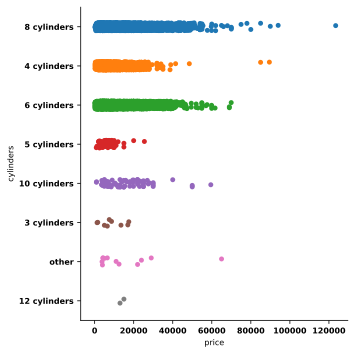

In [107]:
# 'transmission', 'drive', 'condition', 'state', 'fuel', 'cylinders', 'manufacturer', 'type'
v_cylinders = v_sample[['price','cylinders']]
sns.catplot(x="price", y="cylinders", data=v_cylinders)

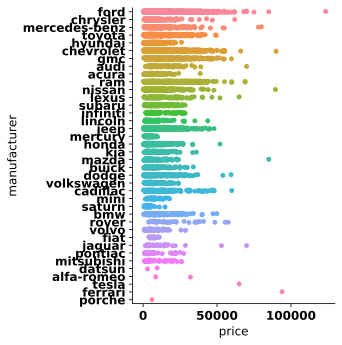

In [24]:
# 'transmission', 'drive', 'condition', 'state', 'fuel', 'cylinders', 'manufacturer', 'type'
v_manufacturer = v_sample[['price','manufacturer']]
sns.catplot(x="price", y="manufacturer", data=v_manufacturer)

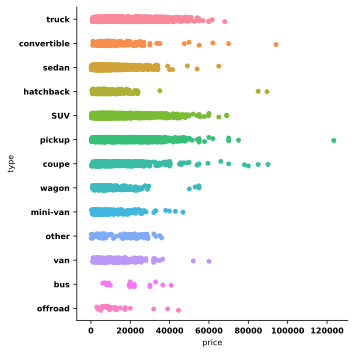

In [108]:
# 'transmission', 'drive', 'condition', 'state', 'fuel', 'cylinders', 'manufacturer', 'type'
v_type = v_sample[['price','type']]
sns.catplot(x="price", y="type", data=v_type)

In [116]:
# Price values above 100,000 seems to be uncommon.Only few vehicles from Mercedes and 
# Chevrolet are having these prices. Removing them would help us analyse better
vehicles_df = vehicles_df.loc[vehicles_df['price'] < 100000]
vehicles_df.shape

(145357, 11)

In [92]:
vehicles_df_sample = vehicles_df.sample(100000)
X = vehicles_df_sample.drop(['price'],axis=1)
y = vehicles_df_sample[['price']]

# Let's try a basic Linear Regression Model

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)

categorical_features = ['condition','fuel','transmission','drive','type','state','manufacturer','cylinders']
continuous_features = ['year','odometer']


preprocess = make_column_transformer(
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

model = make_pipeline(preprocess, LinearRegression())

model.fit(X_train, y_train.values.ravel())

print(model.score(X_test, y_test.values.ravel()))

0.5345339592318654


In [ ]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 8}

plt.rc('font', **font)


# Task3


Doing Target Encoding on state and manufacturer columns rather than doing one hot encoding since they have too many values

In [33]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)


categorical_features = ['condition','fuel','transmission','drive','type','cylinders']
continuous_features = ['year','odometer']
te_cols =['state','manufacturer']

preprocess = make_column_transformer(
        (TargetEncoder(handle_missing='value',handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

#Since state and manufaturer have many values
model = make_pipeline(preprocess, LinearRegression())

model.fit(X_train, y_train)

print(model.score(X_test, y_test))

0.5239780933457098


In [93]:
vehicles_df_sample = vehicles_df.sample(10000)
X = vehicles_df_sample.drop(['price'],axis=1)
y = vehicles_df_sample[['price']]

Analysing the distribution odometer readings against pricing.

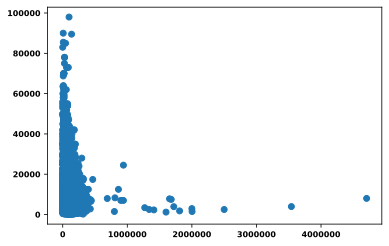

In [94]:
plt.scatter(vehicles_df_sample['odometer'], vehicles_df_sample['price'])

Odometer seems to be having some unreasonably high values since odometer readings cannot have more than six digits max.
Trying to see the readings below 1 million

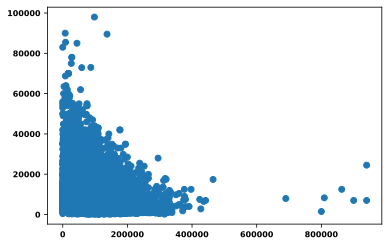

In [95]:
vehicles_odo = vehicles_df_sample.loc[vehicles_df_sample['odometer'] < 1000000]
plt.scatter(vehicles_odo['odometer'], vehicles_odo['price'])

Most of the odometer readings seems to be below 400000. So let's see the distribution on that

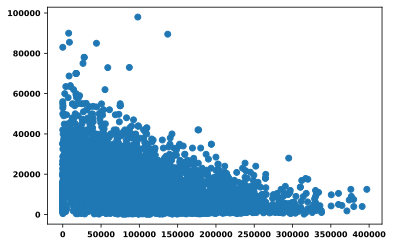

In [96]:
vehicles_odo = vehicles_df_sample.loc[vehicles_df_sample['odometer'] < 400000]
plt.scatter(vehicles_odo['odometer'], vehicles_odo['price'])

Trying odometer readings below 300000

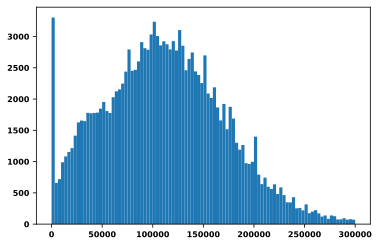

In [97]:
vehicles_odo = vehicles_df.loc[vehicles_df['odometer'] < 300000]
plt.hist(vehicles_odo['odometer'], bins="auto")
print("")

Trying to get a domain knowledge of vehicles having odometer readings above 300000. Let's first see what type of vehicles have such readings.

In [33]:
vehicles_odo = vehicles_df.loc[vehicles_df['odometer'] >= 300000]
vehicles_odo.shape

(1140, 11)

In [ ]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 8
fig_size[1] = 6
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 8}

plt.rc('font', **font)


vehicle_odo dataframe contain rows that have readings greater than or equal to 300000. Let's see the distribution of the type of vehicles having such readings

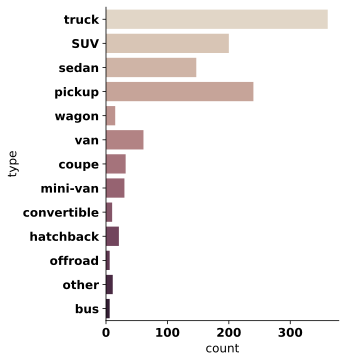

In [34]:
v_type = vehicles_odo[['type']]
sns.catplot(kind="count",y="type", palette="ch:.25", data=v_type);

The below distribution shows the type of vehicles having distance travelled less than 300000

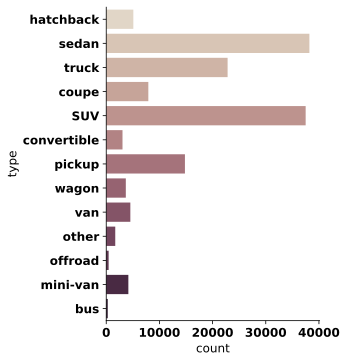

In [35]:
vehicles_odo = vehicles_df.loc[vehicles_df['odometer'] < 300000]
v_type = vehicles_odo[['type']]
sns.catplot(kind="count",y="type", palette="ch:.25", data=v_type);

A large portion of trucks, sedans and SUVs data seems to have distance travelled below 300000 and so removing those rare cases above 300000 wouldn't affect our prediction.

In [117]:
vehicles_df = vehicles_df.loc[vehicles_df['odometer'] < 300000]

In [ ]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 8}

plt.rc('font', **font)


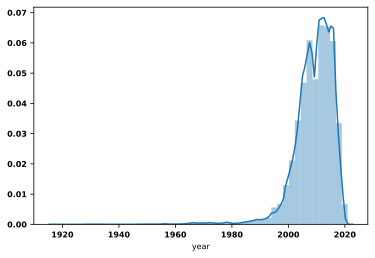

In [99]:
sns.distplot(vehicles_df['year'])

Let's consider only the years above 1985 for our analysis. Also we can see that there are values greater than 2020. Let's remove that as well.

In [118]:
vehicles_df = vehicles_df.loc[(vehicles_df['year'] > 1985) & (vehicles_df['year'] < 2021)]


# Converting the year to age of the vehicle

In [119]:
vehicles_df[['year']] = 2020 - vehicles_df['year']

# Removing the word 'cylinders' from the cylinders column.

In [120]:
vehicles_df['cylinders']=vehicles_df['cylinders'].str.replace('cylinders','')
vehicles_df['cylinders'] = pd.to_numeric(vehicles_df['cylinders'], errors='coerce')


# There is a category 'other' in the cylinder column, so populating that with the mean

In [121]:
vehicles_df['cylinders'].fillna(vehicles_df['cylinders'].mean(),inplace=True)

In [122]:
vehicles_df.head()

,price,year,manufacturer,condition,cylinders,fuel,odometer,transmission,drive,type,state
0,17899,8.0,volkswagen,excellent,4.0,gas,63500.0,manual,4wd,hatchback,ut
24,4600,12.0,honda,good,4.0,gas,110982.0,automatic,fwd,sedan,ut
48,28000,16.0,ford,good,10.0,gas,67348.0,automatic,4wd,truck,ut
52,18999,5.0,mercedes-benz,excellent,4.0,gas,37000.0,automatic,fwd,sedan,ut
53,79997,4.0,mercedes-benz,excellent,8.0,gas,28000.0,automatic,rwd,coupe,ut


# Task4

In [43]:
vehicles_df.shape

(142358, 11)

In [44]:
sample = vehicles_df.sample(100000)
X = sample.drop(['price'],axis=1)
y = sample[['price']]

In [235]:
from sklearn.ensemble import RandomForestRegressor

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)


categorical_features = ['condition','fuel','transmission','drive','type','cylinders']
continuous_features = ['year','odometer']
te_cols =['state','manufacturer']

preprocess = make_column_transformer(
        (TargetEncoder(handle_missing='value',handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

#Since state and manufaturer have many values
model = make_pipeline(preprocess,RandomForestRegressor(max_depth=10))

model.fit(X_train, y_train)

print(model.score(X_test, y_test))

0.7999767605328986


In [45]:
conda install -c conda-forge xgboost

Solving environment: done

## Package Plan ##

  environment location: /opt/anaconda3

  added / updated specs:
    - xgboost


The following packages will be UPDATED:

  conda                       pkgs/main::conda-4.8.3-py37_0 --> conda-forge::conda-4.8.3-py37hc8dfbb8_1


Preparing transaction: done
Verifying transaction: done
Executing transaction: done

Note: you may need to restart the kernel to use updated packages.


In [241]:
from xgboost import XGBRegressor

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)

categorical_features = ['condition','fuel','transmission','drive','type','cylinders']
continuous_features = ['year','odometer']
te_cols =['state','manufacturer']

preprocess = make_column_transformer(
        (TargetEncoder(handle_missing='value',handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

# Since state and manufaturer have many values
model = make_pipeline(preprocess,XGBRegressor(max_depth=12))

model.fit(X_train, y_train)

print(model.score(X_test, y_test))


[21:12:01] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.8639521598564572


In [ ]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 8}

plt.rc('font', **font)


# Visualizing the predicted and the original

In [109]:
from warnings import filterwarnings
filterwarnings('ignore')

In [125]:
sample = vehicles_df.sample(10000)
X = sample.drop(['price'],axis=1)
y = sample[['price']]

In [126]:
from sklearn import ensemble
from sklearn.metrics import r2_score
from xgboost import XGBRegressor

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)

categorical_features = ['condition','fuel','transmission','drive','type','cylinders']
continuous_features = ['year','odometer']
te_cols =['state','manufacturer']

preprocess = make_column_transformer(
        (TargetEncoder(handle_missing='value',handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

params = {
    'n_estimators': 100,
    'max_depth': 12,
    'learning_rate': 0.1,
    'warm_start': True
}

    xgb_regressor = XGBRegressor(**params)

# Since state and manufaturer have many values
model = make_pipeline(preprocess,PolynomialFeatures(2),xgb_regressor)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))
print(model.score(X_test, y_test))


[18:12:48] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.8125032437740303
0.8125032437740303


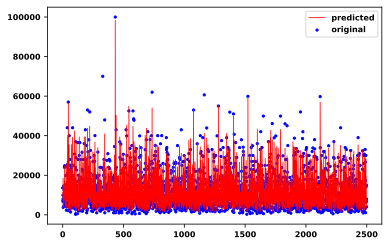

In [127]:
x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s=5, c="blue", label="original")
plt.plot(x_ax, y_pred, lw=0.8, c="red", label="predicted")
plt.legend()
plt.show()

# Parameter Tuning

# Creating a new DataFrame to have all the changes in one place for convenience

In [ ]:
I tried a number of models like DecisionTreeRegressor, RandomForestRegressor, CatBoostRegressor, 
GradientBoostRegressor and SVM. But only a few gave me a good score, so I have left only them in this assignment.

In [72]:
drop_columns = ['id','county','url','region','region_url', 'title_status', 'vin', 'size', 
                'image_url', 'description', 'lat','long', 'paint_color']


vdf = df.drop(columns = drop_columns)
vdf = vdf.dropna()
vdf = vdf.drop(['model'],axis=1)
vdf = vdf.loc[vdf['price'] > 100]
vdf = vdf.loc[vdf['price'] < 100000]
vdf = vdf.loc[(vdf['year'] > 1985) & (vdf['year'] < 2021)]
vdf[['year']] = 2020 - vdf['year']
vdf = vdf.loc[vdf['odometer'] < 300000]
vdf['cylinders'] = vdf['cylinders'].str.replace('cylinders','')
vdf['cylinders'] = pd.to_numeric(vdf['cylinders'], errors='coerce')
vdf['cylinders'].fillna(vdf['cylinders'].mean(), inplace=True)

vdf_sample = vdf.sample(100000)
X = vdf_sample[vdf_sample.columns[1:11]]
y = vdf_sample[vdf_sample.columns[0]]


In [53]:
vdf_sample.head()

,price,year,manufacturer,condition,cylinders,fuel,odometer,transmission,drive,type,state
138278,9999,9.0,toyota,excellent,6.0,gas,199000.0,automatic,4wd,mini-van,co
48087,14000,5.0,volkswagen,excellent,4.0,gas,65000.0,automatic,fwd,hatchback,wi
256215,17900,4.0,chevrolet,excellent,6.0,gas,55000.0,automatic,fwd,sedan,la
111357,2979,18.0,subaru,like new,4.0,gas,187690.0,automatic,4wd,wagon,ca
448086,4400,10.0,honda,excellent,4.0,gas,190000.0,automatic,fwd,sedan,pa


In [33]:
pip install catboost

Note: you may need to restart the kernel to use updated packages.


# Extra Tree Regressor with AdaBoostRegressor

In [257]:
from sklearn.tree import ExtraTreeRegressor
from sklearn.ensemble import AdaBoostRegressor

categorical_features = ['condition','fuel','transmission','drive','type']
continuous_features = ['cylinders','year','odometer']
te_cols =['state','manufacturer']

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)


preprocess = make_column_transformer(
        (TargetEncoder(handle_missing='value',handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

et_regressor = ExtraTreeRegressor(random_state=0)
ada = AdaBoostRegressor(et_regressor, random_state=0,n_estimators=100)

model = make_pipeline(preprocess,ada)


model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))
print(model.score(X_test, y_test))

0.8673365581810368
0.8673365581810368


# ExtraTreeRegressor with AdaBoostRegressor -  Parameter Tuning

In [305]:

from sklearn.tree import ExtraTreeRegressor
from sklearn.ensemble import AdaBoostRegressor


categorical_features = ['condition','fuel','transmission','drive','type']
continuous_features = ['cylinders','year','odometer']
te_cols =['state','manufacturer']

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)


preprocess = make_column_transformer(
        (TargetEncoder(handle_missing='value',handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

param_grid = {'adaboostregressor__n_estimators': [50,100,200]}

et_regressor = ExtraTreeRegressor(max_depth=12,random_state=0)
ada = AdaBoostRegressor(et_regressor, random_state=0)

pipe = make_pipeline(preprocess,ada)

grid = GridSearchCV(pipe, param_grid=param_grid,cv=5, n_jobs=-1)
grid.fit(X_train, y_train)
print(grid.best_params_)
print(grid.score(X_test, y_test))

{'adaboostregressor__n_estimators': 50}
0.8169392446833049


# XGBRegressor

In [259]:

from xgboost import XGBRegressor
from sklearn.metrics import r2_score

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)

categorical_features = ['condition','fuel','transmission','drive','type']
continuous_features = ['cylinders','year','odometer']
te_cols =['state','manufacturer']


preprocess = make_column_transformer(
        (TargetEncoder(handle_missing='value',handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

params = {
    'n_estimators': 100,
    'max_depth': 12,
    'learning_rate': 0.1,
    'tree_method':'hist',
    'warm_start': True
}

xgb_regressor = XGBRegressor(**params)

model = make_pipeline(preprocess,PolynomialFeatures(2),xgb_regressor)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))
print(model.score(X_test, y_test))

[21:48:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.8732051498201588
0.8732051498201588


# XGBRegressor - Parameter Tuning

In [306]:
from xgboost import XGBRegressor
from sklearn.metrics import r2_score


categorical_features = ['condition','fuel','transmission','drive','type']
continuous_features = ['cylinders','year','odometer']
te_cols =['state','manufacturer']

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=0)


preprocess = make_column_transformer(
        (TargetEncoder(handle_missing='value',handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))


pipe = make_pipeline(preprocess,XGBRegressor(tree_method='hist',warm_start=True))

param_grid = {'xgbregressor__n_estimators': [100,200,500,1000],'xgbregressor__max_depth': [8,10,12,14]}

grid = GridSearchCV(pipe, param_grid,cv=10, n_jobs=-1)
grid.fit(X_train, y_train)
print(grid.best_params_)
print(grid.score(X_test, y_test))

[00:24:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
{'xgbregressor__max_depth': 10, 'xgbregressor__n_estimators': 500}
0.8693675230981683


In [54]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 10
fig_size[1] = 8
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 4}

plt.rc('font', **font)

# Task 5

# Feature Selection

# Transforming the features explicitly and going to find the best among them

In [73]:
X_local = X
categorical_features = ['condition','fuel','transmission','drive','type']
continuous_features = ['cylinders','year','odometer']
te_cols =['state','manufacturer']

te = TargetEncoder(cols= te_cols,handle_missing='value', handle_unknown='value')
te.fit(X_local,y)
X_local = te.transform(X_local)
te_cols = te.get_feature_names()

X_local = pd.get_dummies(X_local, columns=categorical_features)
te_ohe_cols = list(X_local.columns)

s = StandardScaler()
s.fit(X_local[['year','odometer']])
X_local[['year','odometer']] = s.transform(X_local[['year','odometer']])


X_transformed = X_local 


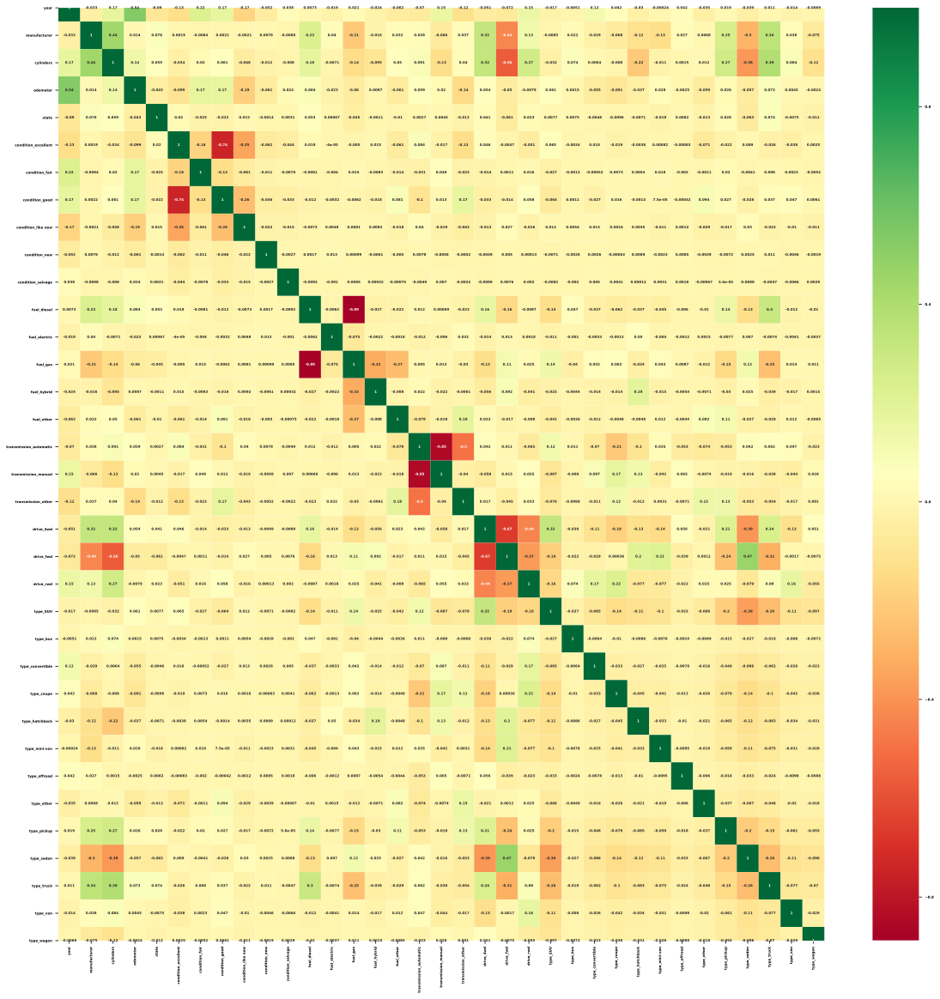

In [56]:
import pandas as pd
import numpy as np
import seaborn as sns

corrmat = X_transformed.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(20,20))
#plot heat map
g=sns.heatmap(X_transformed[top_corr_features].corr(),annot=True,cmap="RdYlGn")

Odometer and year seems to be a bit correlated. Let's try dropping it.

In [261]:
from xgboost import XGBRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest, SelectPercentile, SelectFpr

X_no_odo = X.drop(['odometer'],axis=1)

X_train, X_test, y_train, y_test = train_test_split(X_no_odo,y,random_state=0)

categorical_features = ['condition','fuel','transmission','drive','type']
continuous_features = ['cylinders','year']
te_cols =['state','manufacturer']

preprocess = make_column_transformer(
        (TargetEncoder(handle_missing ='value', handle_unknown='value'), te_cols),
        (OneHotEncoder(handle_unknown='ignore'),categorical_features),
        (StandardScaler(), continuous_features))

params = {
    'n_estimators': 100,
    'max_depth': 12,
    'learning_rate': 0.1,
    'tree_method':'hist',
    'warm_start': True
}

xgb_regressor = XGBRegressor(**params)


model = make_pipeline(preprocess,PolynomialFeatures(2),SelectKBest(k=200, score_func=f_regression),xgb_regressor)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))
print(model.score(X_test, y_test))

[21:50:28] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.8317299929486696
0.8317299929486696


Dropping odometer doesn't seem to improve the score

In [59]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 6
fig_size[1] = 4
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 8}

plt.rc('font', **font)


# Random Forest - Selecting based on Feature Importances

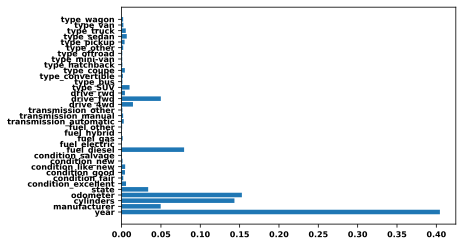

In [60]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_transformed,y,random_state=0)


params = {
    'n_estimators': 100,
    'n_jobs':-1,
    'warm_start': True
}

rf_regressor = RandomForestRegressor(**params).fit(X_train, y_train)


plt.barh(range(len(rf_regressor.feature_importances_)), rf_regressor.feature_importances_)
plt.yticks(range(len(rf_regressor.feature_importances_)), list(X_transformed.columns))
print("")

Text(0.5, 1.0, 'Random Forest Regressor')

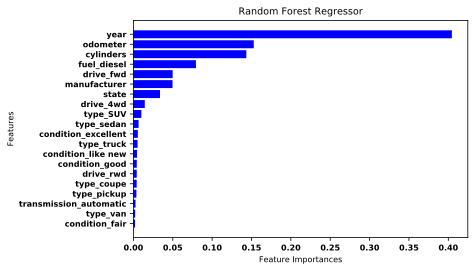

In [61]:
cols = list(X_transformed.columns)

all_columns = np.hstack([cols])

rf_feat = rf_regressor.feature_importances_

rf_abs =  [abs(ele) for ele in rf_feat]
rf_indices = np.argsort(rf_abs)
rf_indices_20imp = rf_indices[-20:]
top_rf_feat = rf_feat[rf_indices_20imp]
top_rf_features = all_columns[rf_indices_20imp]

colors = ['b' if ele==1.0 else 'r' for ele in np.sign(top_rf_feat)]
fig, ax = plt.subplots(1,1)
ax.barh(top_rf_features,top_rf_feat,color=colors)
ax.set_xlabel('Feature Importances')
ax.set_ylabel('Features')
ax.set_title('Random Forest Regressor')

# RandomForestRegressor on selected 20 features

In [267]:
from sklearn.ensemble import RandomForestRegressor

X_selected = X_transformed.loc[:,X_transformed.columns.isin(top_rf_features)] 

X_train, X_test, y_train, y_test = train_test_split(X_selected,y,random_state=0)

params = {
    'n_estimators': 100,
    'n_jobs':-1,
    'warm_start': True
}

rf_regressor = RandomForestRegressor(**params)


model = make_pipeline(rf_regressor)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))
print(model.score(X_test, y_test))


0.866429539215164
0.866429539215164


# ExtraTreeRegressor with AdaBoostRegressor - Selecting based on Feature Importances

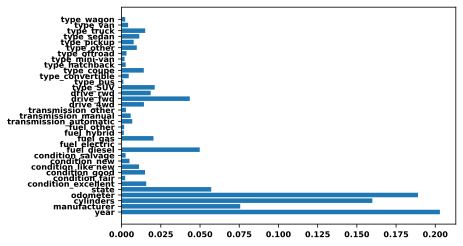

In [62]:
from sklearn.tree import ExtraTreeRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_transformed,y,random_state=0)

extra_tree = ExtraTreeRegressor(random_state=0)
ada = AdaBoostRegressor(extra_tree, random_state=0,n_estimators=100).fit(X_train, y_train)

plt.barh(range(len(ada.feature_importances_)), ada.feature_importances_)
plt.yticks(range(len(ada.feature_importances_)), list(X_transformed.columns))
print("")

Text(0.5, 1.0, 'Extra Tree Regressor')

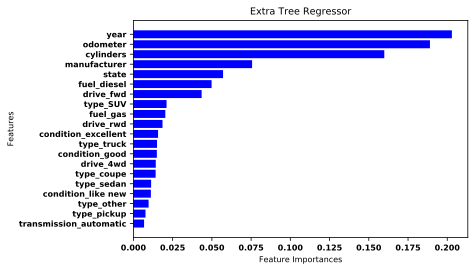

In [63]:
cols = list(X_transformed.columns)

all_columns = np.hstack([cols])

ada_feat = ada.feature_importances_

ada_abs =  [abs(ele) for ele in ada_feat]
ada_indices = np.argsort(ada_abs)
ada_indices_20imp = ada_indices[-20:]
top_ada_feat = ada_feat[ada_indices_20imp]
top_ada_features = all_columns[ada_indices_20imp]

colors = ['b' if ele==1.0 else 'r' for ele in np.sign(top_ada_feat)]
fig, ax = plt.subplots(1,1)
ax.barh(top_ada_features,top_ada_feat,color=colors)
ax.set_xlabel('Feature Importances')
ax.set_ylabel('Features')
ax.set_title('Extra Tree Regressor')

Trying with BaggingRegressor on the top 20 features

In [279]:
from sklearn.tree import ExtraTreeRegressor
from sklearn.ensemble import BaggingRegressor

X_selected = X_transformed.loc[:,X_transformed.columns.isin(top_ada_features)] 

X_train, X_test, y_train, y_test = train_test_split(X_selected,y,random_state=0)

extra_tree = ExtraTreeRegressor(random_state=0)

reg = BaggingRegressor(extra_tree,n_estimators=100, random_state=0).fit(X_train, y_train)
reg.score(X_test, y_test)



0.8724374491388001

**With AdaRegressor on the top 20 features. This seems to be my best model so far**

In [280]:
from sklearn.tree import ExtraTreeRegressor
from sklearn.ensemble import AdaBoostRegressor

X_selected = X_transformed.loc[:,X_transformed.columns.isin(top_ada_features)] 

X_train, X_test, y_train, y_test = train_test_split(X_selected,y,random_state=0)

extra_tree = ExtraTreeRegressor(random_state=0)

ada = AdaBoostRegressor(extra_tree, random_state=0,n_estimators=100).fit(X_train, y_train)
ada.score(X_test, y_test)

0.8737682607131424

# XGBRegressor - Selecting Features based on Feature Importances

[16:37:20] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.



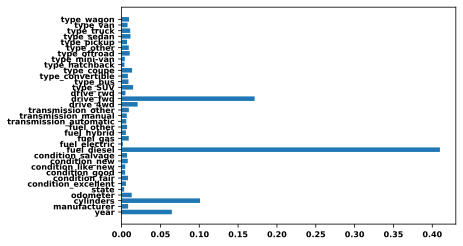

In [64]:
from xgboost import XGBRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_transformed,y,random_state=0)


params = {
    'n_estimators': 100,
    'max_depth': 12,
    'learning_rate': 0.1,
    'tree_method':'hist',
    'warm_start': True
}

xgb_regressor = XGBRegressor(**params).fit(X_train, y_train)


plt.barh(range(len(xgb_regressor.feature_importances_)), xgb_regressor.feature_importances_)
plt.yticks(range(len(xgb_regressor.feature_importances_)), list(X_transformed.columns))
print("")

Text(0.5, 1.0, 'XGB Regressor')

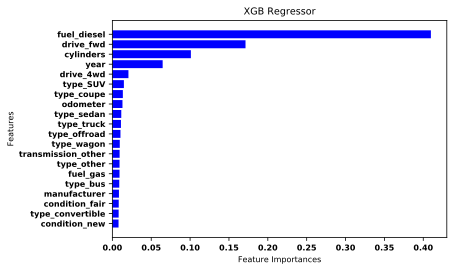

In [65]:
cols = list(X_transformed.columns)

all_columns = np.hstack([cols])

xgb_feat = xgb_regressor.feature_importances_

xgb_abs =  [abs(ele) for ele in xgb_feat]
xgb_indices = np.argsort(xgb_abs)
xgb_indices_20imp = xgb_indices[-20:]
top_xgb_feat = xgb_feat[xgb_indices_20imp]
top_xgb_features = all_columns[xgb_indices_20imp]

colors = ['b' if ele==1.0 else 'r' for ele in np.sign(top_xgb_feat)]
fig, ax = plt.subplots(1,1)
ax.barh(top_xgb_features,top_xgb_feat,color=colors)
ax.set_xlabel('Feature Importances')
ax.set_ylabel('Features')
ax.set_title('XGB Regressor')

XGBRegressor on top 20 features

In [283]:
from xgboost import XGBRegressor

X_selected = X_transformed.loc[:,X_transformed.columns.isin(top_xgb_features)] 

X_train, X_test, y_train, y_test = train_test_split(X_selected,y,random_state=0)

params = {
    'n_estimators': 100,
    'max_depth': 12,
    'learning_rate':0.1,
    'tree_method':'hist',
    'warm_start': True
}

xgb_regressor = XGBRegressor(**params)


model = make_pipeline(xgb_regressor)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))
print(model.score(X_test, y_test))

[22:06:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.8665634984175327
0.8665634984175327


**XGBRegressor with AdaBoostRegressor is THE BEST MODEL**

In [299]:
from sklearn.ensemble import AdaBoostRegressor

X_selected = X_transformed.loc[:,X_transformed.columns.isin(top_xgb_features)] 

X_train, X_test, y_train, y_test = train_test_split(X_selected,y,random_state=0)

params = {
    'n_estimators': 500,
    'max_depth': 10,
    'warm_start': True,
    'tree_method':'hist',
    'silent':True
}

xgb_regressor = XGBRegressor(**params)

ada = AdaBoostRegressor(xgb_regressor, random_state=0,n_estimators=50).fit(X_train, y_train)
ada.score(X_test, y_test)

0.8745858026183859

In [287]:
from sklearn.ensemble import AdaBoostRegressor

X_selected = X_transformed.loc[:,X_transformed.columns.isin(top_xgb_features)] 

X_train, X_test, y_train, y_test = train_test_split(X_transformed,y,random_state=0)

params = {
    'n_estimators': 200,
    'max_depth': 12,
    'warm_start': True,
    'tree_method':'hist',
    'silent':True
}

xgb_regressor = XGBRegressor(**params)

ada = AdaBoostRegressor(xgb_regressor, random_state=0,n_estimators=50).fit(X_train, y_train)
ada.score(X_test, y_test)

0.8870703808353672

# ***The highest score is 0.887***

# Task6 - Explainable Model

Trying to create an explainable model as close as possible to my best model

In [74]:
from xgboost import XGBRegressor
from xgboost import plot_tree
import matplotlib.pyplot as plt

X_train, X_test, y_train, y_test = train_test_split(X_transformed,y,random_state=0)
tree = XGBRegressor(n_estimators=5000,max_depth=5, warm_start=True, tree_method='hist')

tree.fit(X_train, y_train)
tree.score(X_test,y_test)


[16:48:09] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


0.8793862483947368

In [75]:
conda install python-graphviz

Solving environment: done

## Package Plan ##

  environment location: /opt/anaconda3

  added / updated specs:
    - python-graphviz


The following packages will be SUPERSEDED by a higher-priority channel:

  conda              conda-forge::conda-4.8.3-py37hc8dfbb8~ --> pkgs/main::conda-4.8.3-py37_0


Preparing transaction: done
Verifying transaction: done
Executing transaction: done

Note: you may need to restart the kernel to use updated packages.


In [84]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0] = 80
fig_size[1] = 60
plt.rcParams["figure.figsize"] = fig_size


font = {'weight' : 'bold',
        'size'   : 4}

plt.rc('font', **font)

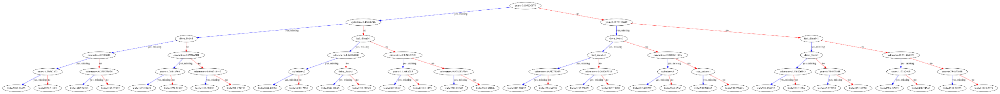

In [85]:
from xgboost import plot_tree
# fig_size = plt.rcParams["figure.figsize"]
# fig_size[0] = 60
# fig_size[1] = 20
# plt.rcParams["figure.figsize"] = fig_size


# font = {'family' : 'monospace',
#         'weight' : 'bold',
#         'size'   : 22}

# plt.rc('font', **font)
fig, ax0 = plt.subplots(nrows=1, ncols=1)
fig = plt.gcf()
# fig.set_size_inches(60, 40)

plot_tree(tree,ax=ax0)
plt.show()

fig.savefig('depth5_tree.png')

Kindly look into the attached .png file or my jupyter notebook in github classroom for a complete picture of the tree

# Explainable Model with depth max_depth=4 inorder to make it better interpretable

In [77]:
from xgboost import XGBRegressor
from xgboost import plot_tree
import matplotlib.pyplot as plt

# X_train, X_test, y_train, y_test = train_test_split(X_transformed,y,random_state=0)

tree = XGBRegressor(n_estimators=8000,max_depth=4, warm_start=True, tree_method='hist')

tree.fit(X_train, y_train)
tree.score(X_test,y_test)


[16:51:03] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


0.8727997394913818

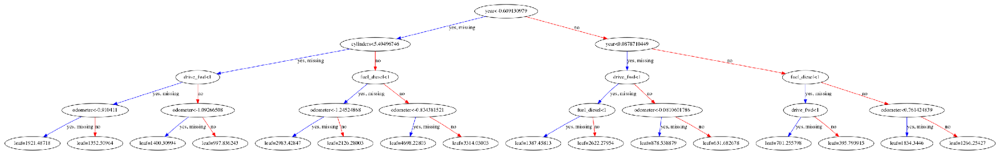

In [78]:
# fig_size = plt.rcParams["figure.figsize"]
# fig_size[0] = 40
# fig_size[1] = 20
# plt.rcParams["figure.figsize"] = fig_size


# font = {'weight' : 'bold',
#         'size'   : 12}

# plt.rc('font', **font)
fig, ax0 = plt.subplots(nrows=1, ncols=1)

# plt.figure(figsize=(20,20))
# , ax=ax0


fig = plt.gcf()
fig.set_size_inches(40, 20)


plot_tree(tree,ax=ax0)
plt.show()

fig.savefig('depth4_tree.png')

Kindly scroll to get an idea of the complete tree

Kindly look into the attached .png file or my jupyter notebook in github classroom for a complete picture of the tree